In [208]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from matplotlib import pyplot

CRIME DISTANCE VISUALISATION ON MAP BY DISTRICT

In [209]:
# Run this cell to download the datasets in the data directory
!curl https://wagon-public-datasets.s3.amazonaws.com/certification_france_2021_q2/incident_reports.csv > data/incident_reports.csv   
!curl https://wagon-public-datasets.s3.amazonaws.com/certification_france_2021_q2/districts.csv > data/districts.csv    

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
 43 19.1M   43 8442k    0     0  11.2M      0  0:00:01 --:--:--  0:00:01 11.2M
100 19.1M  100 19.1M    0     0  12.4M      0  0:00:01  0:00:01 --:--:-- 12.5M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100   498  100   498    0     0   2394      0 --:--:-- --:--:-- --:--:--  2394


In [210]:
# Load the dataset
from data import load_data_viz_data

data = load_data_viz_data()
data[['LAT','LONG']] = data[['LAT','LONG']].astype('float64')

print("Shape of the DataFrame:", data.shape)

data.head()

Shape of the DataFrame: (237221, 9)


,INCIDENT_NUMBER,OFFENSE_CODE_GROUP,SHOOTING,OCCURRED_ON_DATE,LAT,LONG,NAME,LAT_POLICE_STATION,LONG_POLICE_STATION
0,I192068249,Other,0,2015-08-28 10:20:00,42.330119,-71.084251,Roxbury,42.328894,-71.085359
1,I182074094,Violence and harassment,0,2015-09-14 09:31:00,42.315142,-71.067047,Roxbury,42.328894,-71.085359
2,I182054888,Violence and harassment,0,2015-07-12 15:37:00,42.312243,-71.075499,Roxbury,42.328894,-71.085359
3,I182054888,Other,0,2015-07-12 15:37:00,42.312243,-71.075499,Roxbury,42.328894,-71.085359
4,I182054888,Other,0,2015-07-12 15:37:00,42.312243,-71.075499,Roxbury,42.328894,-71.085359


In [211]:
from math import radians, sin, cos, asin, sqrt

def haversine_distance(lon1, lat1, lon2, lat2):
    """
    Compute distance (km) between two pairs of (lat, lng) coordinates
    See - (https://en.wikipedia.org/wiki/Haversine_formula)
    """
    
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    
    a = sin(dlat / 2) ** 2 + cos(lat1) * cos(lat2) * sin(dlon / 2) ** 2
    
    return 2 * 6371 * asin(sqrt(a))

In [212]:
data['distance'] =data.apply(lambda x: haversine_distance(x['LONG'], x['LAT'],x['LONG_POLICE_STATION'],x['LAT_POLICE_STATION']), axis=1) 

In [213]:
data

,INCIDENT_NUMBER,OFFENSE_CODE_GROUP,SHOOTING,OCCURRED_ON_DATE,LAT,LONG,NAME,LAT_POLICE_STATION,LONG_POLICE_STATION,distance
0,I192068249,Other,0,2015-08-28 10:20:00,42.330119,-71.084251,Roxbury,42.328894,-71.085359,0.163832
1,I182074094,Violence and harassment,0,2015-09-14 09:31:00,42.315142,-71.067047,Roxbury,42.328894,-71.085359,2.145919
2,I182054888,Violence and harassment,0,2015-07-12 15:37:00,42.312243,-71.075499,Roxbury,42.328894,-71.085359,2.021175
3,I182054888,Other,0,2015-07-12 15:37:00,42.312243,-71.075499,Roxbury,42.328894,-71.085359,2.021175
4,I182054888,Other,0,2015-07-12 15:37:00,42.312243,-71.075499,Roxbury,42.328894,-71.085359,2.021175
5,I172075854,Fraud and law violations,0,2015-09-02 09:00:00,42.314013,-71.086353,Roxbury,42.328894,-71.085359,1.656718
6,I172065681,Fraud and law violations,0,2015-07-25 02:00:00,42.316339,-71.068800,Roxbury,42.328894,-71.085359,1.950003
7,I172060902,Fraud and law violations,0,2015-11-12 12:00:00,42.316057,-71.078200,Roxbury,42.328894,-71.085359,1.544003
8,I172026505,Fraud and law violations,0,2015-08-01 12:00:00,42.330013,-71.091179,Roxbury,42.328894,-71.085359,0.494307
9,I172014289,Other,0,2015-12-01 12:00:00,42.323410,-71.093396,Roxbury,42.328894,-71.085359,0.899106


In [214]:
count_offense_by_district=data.groupby(['NAME','OFFENSE_CODE_GROUP']).size().reset_index().groupby(['NAME','OFFENSE_CODE_GROUP'])[[0]].max()

In [215]:
count_offense_by_district

0
NAME         OFFENSE_CODE_GROUP                   
Brighton     Disputes                          563
             Drugs and disorderly conduct      809
             Fraud and law violations         1807
             Larceny and vandalism            5274
             Other                             925
             Police investigation procedure   2783
             Violence and harassment          1627
Charlestown  Disputes                          200
             Drugs and disorderly conduct      416
             Fraud and law violations          428
             Larceny and vandalism            1671
             Other                             338
             Police investigation procedure   1162
             Violence and harassment           550
Dorchester   Disputes                         3066
             Drugs and disorderly conduct     2587
             Fraud and law violations         3705
             Larceny and vandalism            9230
             Other                            2792
             Police investigation procedure   7428
             Violence and harassment          4067
Downtown     Disputes                          254
             Drugs and disorderly conduct     2510
             Fraud and law violations         3245
             Larceny and vandalism            9256
             Other                            2034
             Police investigation procedure   5464
             Violence and harassment          3497
East Boston  Disputes                          597
             Drugs and disorderly conduct      995
...                                            ...
Mattapan     Police investigation procedure   7001
             Violence and harassment          3910
Roxbury      Disputes                         3450
             Drugs and disorderly conduct     3040
             Fraud and law violations         4820
             Larceny and vandalism           10471
             Other                            3571
             Police investigation procedure   8030
             Violence and harassment          5495
South Boston Disputes                          596
             Drugs and disorderly conduct     1867
             Fraud and law violations         1654
             Larceny and vandalism            5637
             Other                            1327
             Police investigation procedure   3523
             Violence and harassment          2013
South End    Disputes                          759
             Drugs and disorderly conduct     2191
             Fraud and law violations         3195
             Larceny and vandalism           14012
             Other                            2090
             Police investigation procedure   5540
             Violence and harassment          3471
West Roxbury Disputes                          597
             Drugs and disorderly conduct      721
             Fraud and law violations         1168
             Larceny and vandalism            2915
             Other                             880
             Police investigation procedure   2036
             Violence and harassment          1089

[84 rows x 1 columns]

In [216]:
incident_by_district = data.groupby('NAME').count()

In [217]:
col = ['INCIDENT_NUMBER']
ind=incident_by_district[col]

In [218]:
ind
ind = ind.reset_index()

In [219]:
ind

,NAME,INCIDENT_NUMBER
0,Brighton,13788
1,Charlestown,4765
2,Dorchester,32875
3,Downtown,26260
4,East Boston,9691
5,Hyde Park,12551
6,Jamaica Plain,12802
7,Mattapan,28331
8,Roxbury,38877
9,South Boston,16617


We will first observe the difference of crime by district

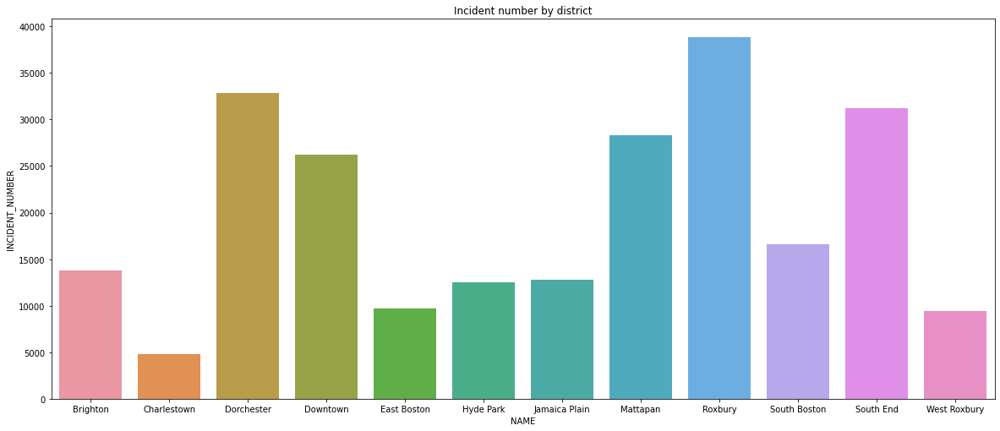

In [222]:
a4_dims = (20, 8.27)
fig, ax = pyplot.subplots(figsize=a4_dims)
plt.xlabel("District")
plt.ylabel("Incident number")
plt.title("Incident number by district")
sns.barplot(data=ind, x="NAME", y="INCIDENT_NUMBER");

In [223]:
count_offense_by_district[0]

NAME          OFFENSE_CODE_GROUP            
Brighton      Disputes                            563
              Drugs and disorderly conduct        809
              Fraud and law violations           1807
              Larceny and vandalism              5274
              Other                               925
              Police investigation procedure     2783
              Violence and harassment            1627
Charlestown   Disputes                            200
              Drugs and disorderly conduct        416
              Fraud and law violations            428
              Larceny and vandalism              1671
              Other                               338
              Police investigation procedure     1162
              Violence and harassment             550
Dorchester    Disputes                           3066
              Drugs and disorderly conduct       2587
              Fraud and law violations           3705
              Larceny and vandalism  

In [224]:
mean_distance = data[['NAME','distance']].groupby('NAME').mean()

In [225]:
mean_distance =mean_distance.reset_index()

In [226]:
mean_distance[mean_distance['NAME'] == 'Brighton']['distance'].iloc[0] 

3.7708668698178434

In [240]:
def couleur_distance(name,distance):
    md = mean_distance[mean_distance['NAME'] == name]['distance'].iloc[0]
    if distance > md:
        return 'red'
    else:
        return 'green'
def couleur_district(name):
    high_crime = ['Roxbury','South End','Downtown','Dorchester']
    if name in high_crime:
        return 'purple'
    else:
        return 'blue'
    

In [228]:
import folium

In [229]:
# YOUR CODE HERE
url = "https://wagon-public-datasets.s3.amazonaws.com/certification_france_2021_q2/boston_crimes_regression.csv"

district = pd.read_csv(url, header=0)


In [230]:
district

,MEDIAN_AGE,TOTAL_POP,PERC_OF_30_34,PERC_MARRIED_COUPLE_FAMILY,PER_CAPITA_INCOME,PERC_OTHER_STATE_OR_ABROAD,PERC_LESS_THAN_HIGH_SCHOOL,PERC_COLLEGE_GRADUATES,CODE,NB_INCIDENTS,NAME
0,30.8,55297,52.8,26.4,41261,8.6,6.7,10.5,D14,13788,Brighton
1,35.7,19890,28.2,36.4,75339,3.4,7.9,8.2,A15,4765,Charlestown
2,33.4,126909,28.2,26.6,29767,2.4,18.0,17.1,C11,32875,Dorchester
3,33.5,18306,32.5,35.8,80057,14.8,15.4,6.9,A1,26260,Downtown
4,30.6,47263,31.1,30.4,31473,3.5,27.2,11.5,A7,9691,East Boston
5,39.4,38924,21.1,38.4,32744,1.9,13.8,21.3,E18,12551,Hyde Park
6,34.8,40867,32.5,33.7,51655,5.5,8.0,12.1,E13,12802,Jamaica Plain
7,36.7,26659,20.9,29.8,28356,2.3,14.5,22.9,B3,28331,Mattapan
8,32.5,54161,27.8,17.8,20978,2.9,23.0,18.9,B2,38877,Roxbury
9,31.9,36772,46.1,24.7,64745,2.4,7.9,8.4,C6,16617,South Boston


We will now observe the number of crime on each district compared to their total population

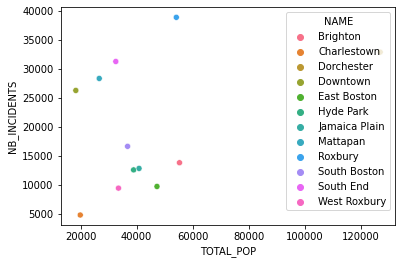

In [231]:
sns.scatterplot(data=district, x="TOTAL_POP", y="NB_INCIDENTS",hue="NAME");

We can clearly see  2 group of district the one with high crime rate like Rowbury,Soouth End and the low crime rate like Charlestown.
On the next slide we will display the crime on map by disctrict with an information on the distance to the police station to see if the high crimes district have a higer distribution of crime commited past a certain distance

In [234]:
def folium_map_district(df):
    
    lat_p = df['LAT_POLICE_STATION'].iloc[0]
    lon_p = df['LONG_POLICE_STATION'].iloc[0]
    m = folium.Map(location=[lat_p, lon_p],zoom_start=11)
    name = df['NAME'].iloc[0]
    color_p = couleur_district(name)
    #print(lat_p,lon_p)
    folium.CircleMarker(
            location=[lat_p, lon_p],
            radius=10,
            color=color_p,
            fill=True,
            fill_color=color_p,
            ).add_to(m)
    for index,row in df.iterrows():     
        lat = row['LAT']
        lon = row['LONG']
        dist = row['distance']
        
        color = couleur_distance(name,dist)
        folium.CircleMarker(
            location=[lat, lon],
            radius=1,
            color=color,
            fill=False

        ).add_to(m)
    return m
    

In [233]:
brighton = data[data['NAME'] == 'Brighton']
Charlestown=data[data['NAME'] == 'Charlestown']
Dorchester=data[data['NAME'] == 'Dorchester']
Downtown=  data[data['NAME'] == 'Downtown']
East_Boston=data[data['NAME'] == 'East Boston']
Hyde_Park=data[data['NAME'] == 'Hyde Park']
Jamaica_Plain=data[data['NAME'] == 'Jamaica Plain']
Mattapan=data[data['NAME'] == 'Mattapan']
Roxbury=data[data['NAME'] == 'Roxbury']
South_Boston=data[data['NAME'] == 'South Boston']
South_End= data[data['NAME'] == 'South End']
West_Roxbury=data[data['NAME'] == 'West Roxbury']

In [235]:
maap_east_bo = folium_map_district(East_Boston)

In [241]:
maap_south_end = folium_map_district(South_End)

In [237]:
maap_east_bo

In [242]:
maap_south_end


WITH MORE TIME WE COULD HAVE COMPARED EACH DISTRICT
BUT BY JUSTE TAKING A DISTRICT WITH HIGH CRIME RATE 
COMPARED TO HIS POPULATION WE CAN SEE THAT HE HAS A LOT
MORE CRIME COMMITED FAR AWAY FROM HIS POLICE STATION
(don't forget you can zoom and move on map slides)